# Pairs Trading using Unsupervised Machine Learning



In developing a Pairs Trading strategy, finding valid, eligible pairs which exhibit unconditional mean-reverting behavior is of critical importance. This project walks through an example implementation of finding eligible pairs. We show how popular algorithms from Machine Learning can help us navigate a very high-dimensional search space to find tradeable pairs.

In [ ]:
!pip install hurst

: 

In [79]:
import matplotlib.pyplot as plt
import matplotlib.cm as cm

import numpy as np
import pandas as pd

from sklearn.cluster import DBSCAN
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
from sklearn import preprocessing
from sklearn.preprocessing import LabelEncoder

from statsmodels.tsa.stattools import coint
from hurst import compute_Hc

from scipy import stats
import yfinance as yf
plt.style.use('seaborn')

## Data
Time: 2015-01-01 to 2019-12-31


Stocks: 1027 stocks(EQ) from NSE, NIFTY50 index as benchmark


Factors: Daily closing price, Industry

In [85]:
data = pd.read_csv('NseFinalData.csv',index_col='Date')
data.head()

,AXISCADES.NS,BAGFILMS.NS,BAJAJ-AUTO.NS,BAJAJCON.NS,BAJAJELEC.NS,BAJAJFINSV.NS,BAJAJHIND.NS,BAJAJHLDNG.NS,BAJFINANCE.NS,BALAJITELE.NS,...,ATUL.NS,ATULAUTO.NS,AURIONPRO.NS,AUROPHARMA.NS,AUSOMENT.NS,AUTOAXLES.NS,AUTOIND.NS,AUTOLITIND.NS,AVTNPL.NS,AXISBANK.NS
Date,,,,,,,,,,,,,,,,,,,,,
02-01-2015,180.250000,3.35,2109.889160,348.182739,222.655853,1271.004272,18.950001,1307.439209,317.966248,67.635872,...,1314.333008,637.727234,208.354172,551.161621,21.299999,654.740295,76.199997,36.799999,36.390137,499.931854
05-01-2015,190.100006,3.50,2117.591553,348.620514,229.239090,1254.115723,19.200001,1326.554321,317.135284,68.791229,...,1284.822876,620.983459,197.167358,550.894043,21.299999,654.554565,74.750000,36.400002,35.614906,503.091003
06-01-2015,178.350006,3.25,2101.068848,336.976471,216.306122,1225.121826,18.850000,1302.478149,316.313538,66.961929,...,1255.313110,600.617920,192.653870,529.407288,21.299999,620.480469,72.500000,34.000000,35.022091,485.107880
07-01-2015,178.199997,3.20,2105.973633,355.711975,214.812225,1224.075684,18.700001,1300.430176,322.753632,68.598663,...,1272.127441,609.460205,203.571167,537.802612,21.299999,642.531128,72.000000,33.750000,34.976482,484.719055
08-01-2015,181.750000,3.20,2108.727539,358.382202,220.881561,1285.102661,18.950001,1334.837646,322.204254,69.320747,...,1255.991577,618.255493,208.161362,548.338867,21.299999,652.465454,72.949997,35.599998,35.386898,487.926880


In [4]:
returns = data.pct_change()
returns.head()

,AXISCADES.NS,BAGFILMS.NS,BAJAJ-AUTO.NS,BAJAJCON.NS,BAJAJELEC.NS,BAJAJFINSV.NS,BAJAJHIND.NS,BAJAJHLDNG.NS,BAJFINANCE.NS,BALAJITELE.NS,...,ATUL.NS,ATULAUTO.NS,AURIONPRO.NS,AUROPHARMA.NS,AUSOMENT.NS,AUTOAXLES.NS,AUTOIND.NS,AUTOLITIND.NS,AVTNPL.NS,AXISBANK.NS
Date,,,,,,,,,,,,,,,,,,,,,
02-01-2015,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
05-01-2015,0.054646,0.044776,0.003651,0.001257,0.029567,-0.013288,0.013193,0.014620,-0.002613,0.017082,...,-0.022453,-0.026255,-0.053691,-0.000485,0.0,-0.000284,-0.019029,-0.010870,-0.021303,0.006319
06-01-2015,-0.061810,-0.071429,-0.007803,-0.033400,-0.056417,-0.023119,-0.018229,-0.018149,-0.002591,-0.026592,...,-0.022968,-0.032796,-0.022892,-0.039003,0.0,-0.052057,-0.030100,-0.065934,-0.016645,-0.035745
07-01-2015,-0.000841,-0.015385,0.002334,0.055599,-0.006906,-0.000854,-0.007958,-0.001572,0.020360,0.024443,...,0.013395,0.014722,0.056668,0.015858,0.0,0.035538,-0.006897,-0.007353,-0.001302,-0.000802
08-01-2015,0.019921,0.000000,0.001308,0.007507,0.028254,0.049856,0.013369,0.026459,-0.001702,0.010526,...,-0.012684,0.014431,0.022548,0.019591,0.0,0.015461,0.013194,0.054815,0.011734,0.006618


In [5]:
returns = returns.iloc[1:,:].dropna(axis=1)
returns.head()

,AXISCADES.NS,BAGFILMS.NS,BAJAJ-AUTO.NS,BAJAJCON.NS,BAJAJELEC.NS,BAJAJFINSV.NS,BAJAJHIND.NS,BAJAJHLDNG.NS,BAJFINANCE.NS,BALAJITELE.NS,...,ATUL.NS,ATULAUTO.NS,AURIONPRO.NS,AUROPHARMA.NS,AUSOMENT.NS,AUTOAXLES.NS,AUTOIND.NS,AUTOLITIND.NS,AVTNPL.NS,AXISBANK.NS
Date,,,,,,,,,,,,,,,,,,,,,
05-01-2015,0.054646,0.044776,0.003651,0.001257,0.029567,-0.013288,0.013193,0.014620,-0.002613,0.017082,...,-0.022453,-0.026255,-0.053691,-0.000485,0.000000,-0.000284,-0.019029,-0.010870,-0.021303,0.006319
06-01-2015,-0.061810,-0.071429,-0.007803,-0.033400,-0.056417,-0.023119,-0.018229,-0.018149,-0.002591,-0.026592,...,-0.022968,-0.032796,-0.022892,-0.039003,0.000000,-0.052057,-0.030100,-0.065934,-0.016645,-0.035745
07-01-2015,-0.000841,-0.015385,0.002334,0.055599,-0.006906,-0.000854,-0.007958,-0.001572,0.020360,0.024443,...,0.013395,0.014722,0.056668,0.015858,0.000000,0.035538,-0.006897,-0.007353,-0.001302,-0.000802
08-01-2015,0.019921,0.000000,0.001308,0.007507,0.028254,0.049856,0.013369,0.026459,-0.001702,0.010526,...,-0.012684,0.014431,0.022548,0.019591,0.000000,0.015461,0.013194,0.054815,0.011734,0.006618
09-01-2015,0.135076,0.000000,-0.030424,0.005741,0.001482,-0.008219,-0.007916,-0.025708,-0.011348,0.042361,...,0.022724,-0.009738,-0.016494,0.038032,0.049296,0.023764,-0.013708,-0.033708,-0.009020,-0.013946


In [6]:
indus = pd.read_csv('Stocks_Industry.csv',index_col=0)
indus.head()

,Industry
AXISCADES.NS,Computers
BAGFILMS.NS,Entertainment
BAJAJ-AUTO.NS,Auto
BAJAJCON.NS,Auto
BAJAJELEC.NS,Appliances


Text(0, 0.5, 'Stock No.')

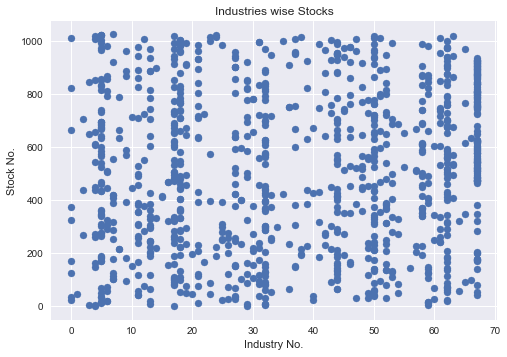

In [ ]:
indus2 = indus.values.flatten().tolist()
label_encoder = LabelEncoder()
indus = label_encoder.fit_transform(indus2)
ind = indus.reshape(1027,1)
y = range(1027)
plt.scatter(ind,y)
plt.title("Industries wise Stocks")
plt.xlabel('Industry No.')
plt.ylabel('Stock No.')

# Find Candidate Pairs


Given the pricing data and the fundamental and industry/sector data, we will first classify stocks into clusters and then, within clusters, looks for strong mean-reverting pair relationships.

The first hypothesis above is that "Stocks that share loadings to common factors in the past should be related in the future". Common factors are things like sector/industry membership and widely known ranking schemes like momentum and value. We could specify the common factors a priori to well known factors, or alternatively, we could let the data speak for itself. In this post we take the latter approach. We use PCA to reduce the dimensionality of the returns data and extract the historical latent common factor loadings for each stock. For a nice visual introduction to what PCA is doing, take a look here.

We will take these features, add in the fundamental features, and then use the DBSCAN unsupervised clustering algorithm which is available in scikit-learn. Thanks to Thomas Wiecki for pointing me to this specific clustering technique and helping with implementation. DBSCAN is used here because it has advantages in this use case, specifically

DBSCAN does not cluster all stocks; it leaves out stocks which do not neatly fit into a cluster;
relatedly, you do not need to specify the number of clusters.
The clustering algorithm will give us sensible candidate pairs. We will need to do some validation in the next step.

### PCA Decomposition and DBSCAN Clustering

In [64]:
pca = PCA(n_components=3)
pca.fit(returns)

PCA(n_components=3)

### Scree plot

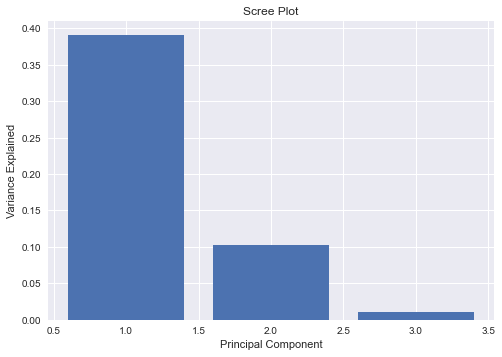

In [65]:
PC_values = np.arange(pca.n_components_) + 1
plt.bar(PC_values, pca.explained_variance_ratio_)
plt.title('Scree Plot')
plt.xlabel('Principal Component')
plt.ylabel('Variance Explained')
plt.show()

In [66]:
np.cumsum(pca.explained_variance_ratio_)

array([0.390886  , 0.49356013, 0.50383934])

In [67]:
pca.components_.T.shape

(1027, 3)

In [68]:
X = pca.components_.T

We have reduced data now with the first 3 principal component loadings. Let's add some fundamental values as well to make the model more robust.

In [69]:
X = np.hstack((pca.components_.T,ind))
X.shape

(1027, 4)

In [70]:
X = preprocessing.StandardScaler().fit_transform(X)

In [71]:
clf = DBSCAN(eps=0.13, min_samples=2)
print(clf)

clf.fit(X)
labels = clf.labels_
n_clusters_ = len(set(labels)) - (1 if -1 in labels else 0)
print("Clusters discovered: %d" % n_clusters_)

clustered = clf.labels_

DBSCAN(eps=0.13, min_samples=2)
Clusters discovered: 166


In [72]:
clustered_series = pd.Series(index=returns.columns, data=clustered.flatten())
clustered_series_all = pd.Series(index=returns.columns, data=clustered.flatten())
clustered_series = clustered_series[clustered_series != -1]

In [73]:
CLUSTER_SIZE_LIMIT = 20
counts = clustered_series.value_counts()
ticker_count_reduced = counts[(counts>1) & (counts<=CLUSTER_SIZE_LIMIT)]
print ("Clusters formed: %d" % len(ticker_count_reduced))
print ("Pairs to evaluate: %d" % (ticker_count_reduced*(ticker_count_reduced-1)).sum())

Clusters formed: 166
Pairs to evaluate: 3730


## Cluster Visualization
We have found 166 clusters. The data are clustered in 4 dimensions. As an attempt to visualize what has happened in 2d, we can try with T-SNE. T-SNE is an algorithm for visualizing very high dimension data in 2d, created in part by Geoff Hinton. We visualize the discovered pairs to help us gain confidence that the DBSCAN output is sensible; i.e., we want to see that T-SNE and DBSCAN both find our clusters.

In [74]:
X_tsne = TSNE(learning_rate=1000, perplexity=25, random_state=1337).fit_transform(X)

C:\Users\Me PC\.conda\envs\tf\lib\site-packages\sklearn\manifold\_t_sne.py:780: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(


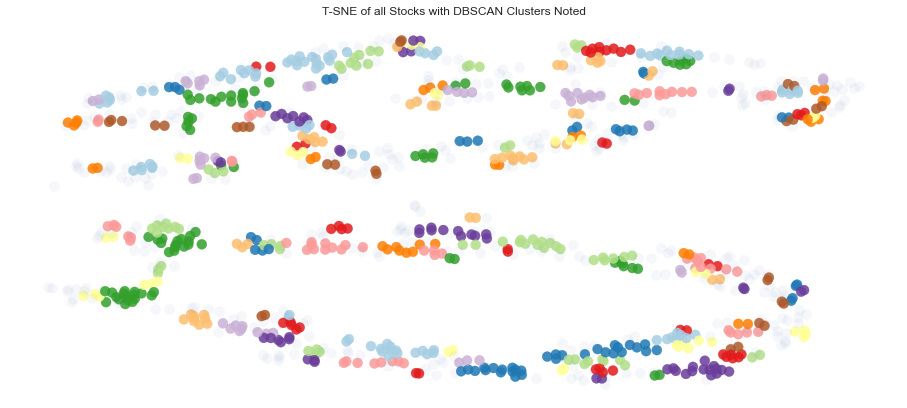

In [75]:
plt.figure(1, facecolor='white',figsize=(16,7))
plt.clf()
plt.axis('off')

plt.scatter(
    X_tsne[(labels!=-1), 0],
    X_tsne[(labels!=-1), 1],
    s=100,
    alpha=0.85,
    c=labels[labels!=-1],
    cmap=cm.Paired
)

plt.scatter(
    X_tsne[(clustered_series_all==-1).values, 0],
    X_tsne[(clustered_series_all==-1).values, 1],
    s=100,
    alpha=0.05
)

plt.title('T-SNE of all Stocks with DBSCAN Clusters Noted');


We can also see how many stocks we found in each cluster and then visualize the normalized time series of the members of a handful of the smaller clusters.

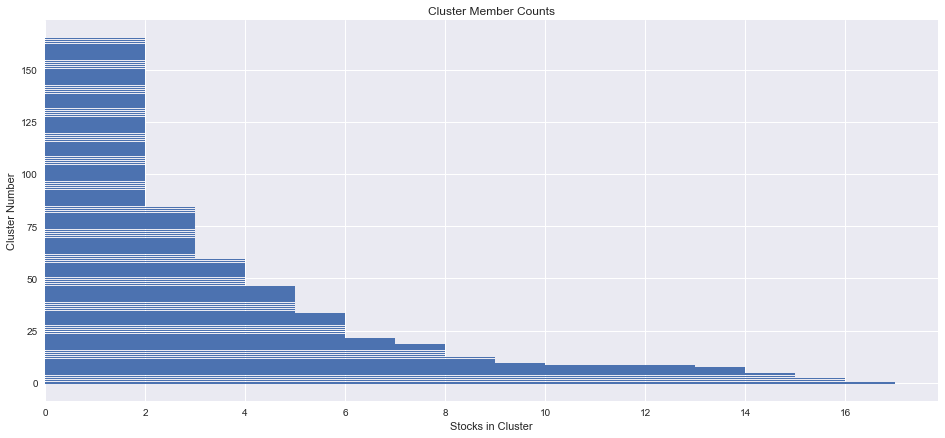

In [76]:
plt.figure(figsize=(16,7))
plt.barh(
    range(len(clustered_series.value_counts())), # cluster labels, y axis
    clustered_series.value_counts()
)
plt.title('Cluster Member Counts')
plt.xlabel('Stocks in Cluster')
plt.ylabel('Cluster Number')
plt.show()



To again visualize if our clustering is doing anything sensible, let's look at a few clusters (for reproducibility, keep all random state and dates the same in this notebook).

166


<Figure size 1152x576 with 0 Axes>

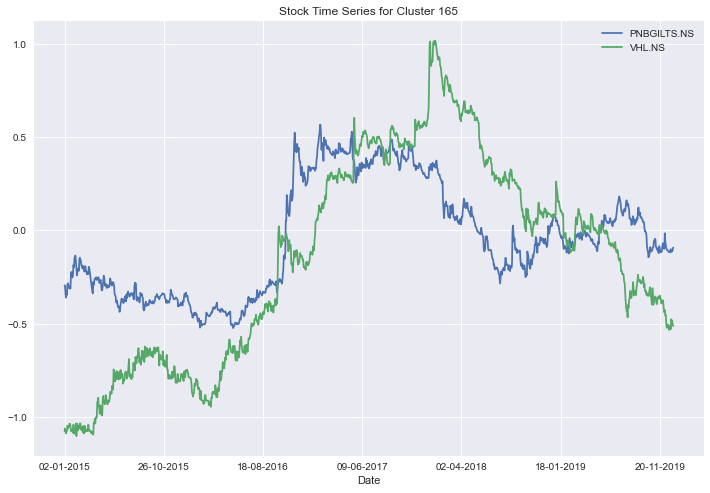

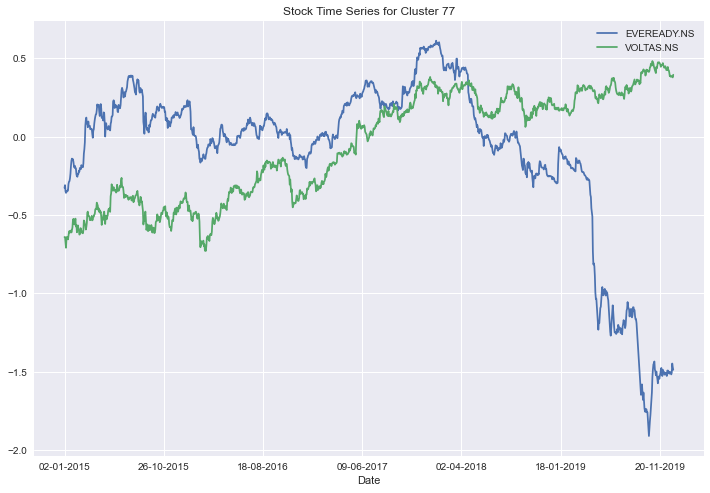

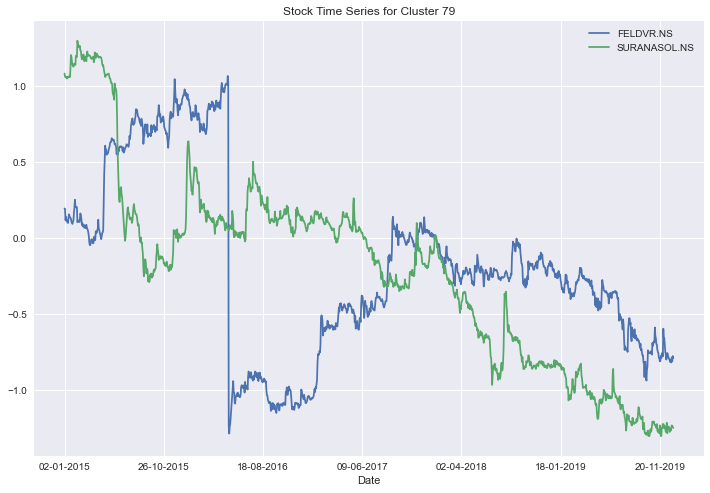

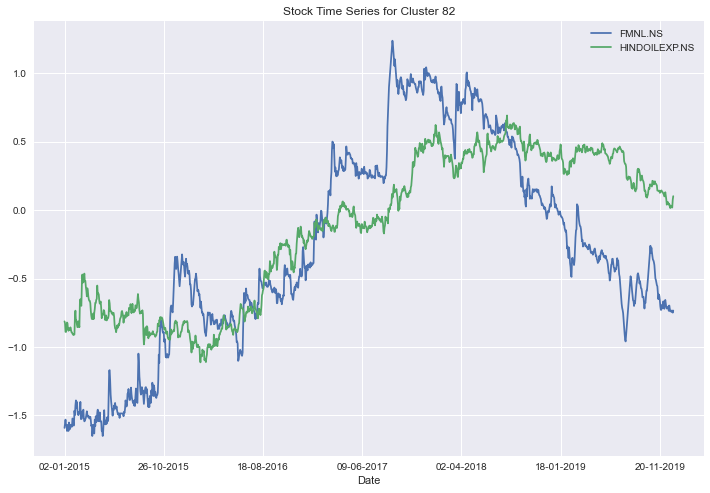

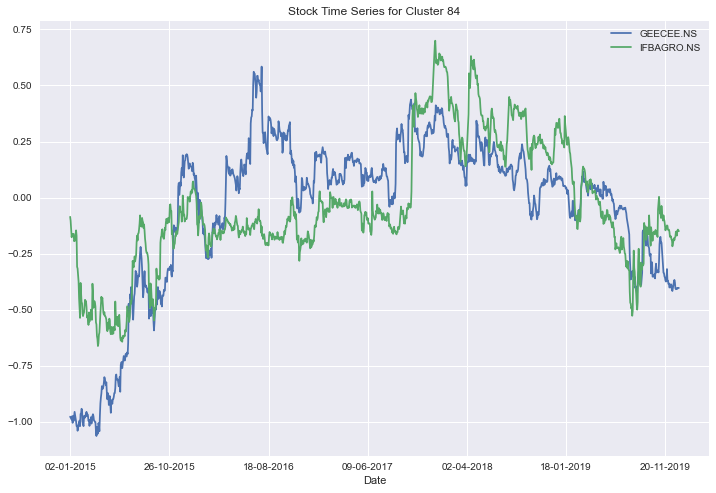

...

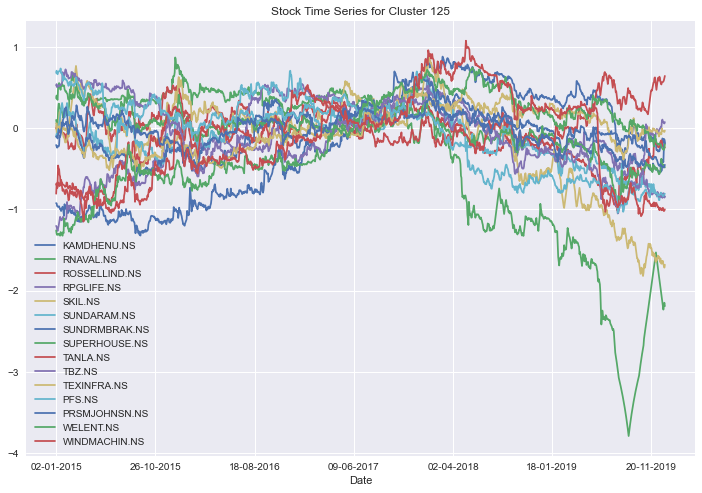

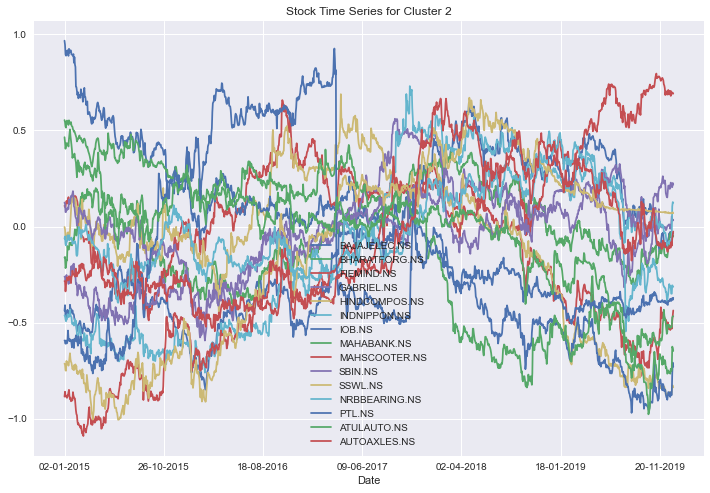

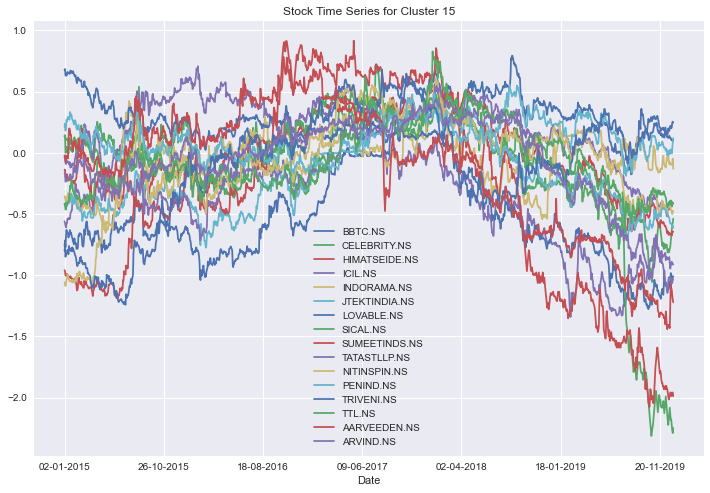

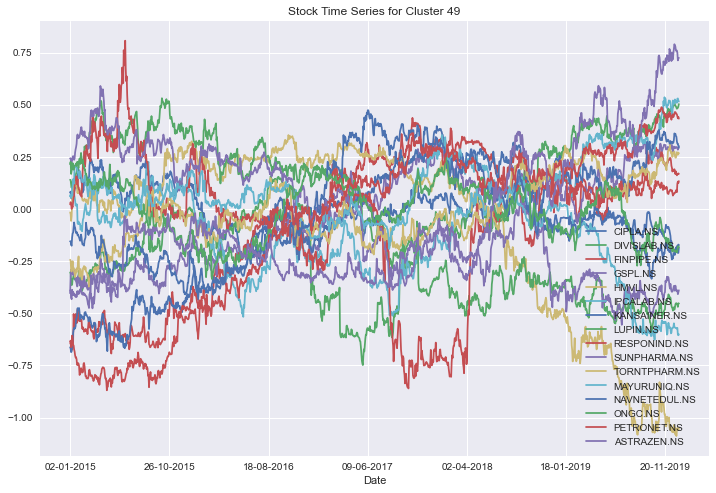

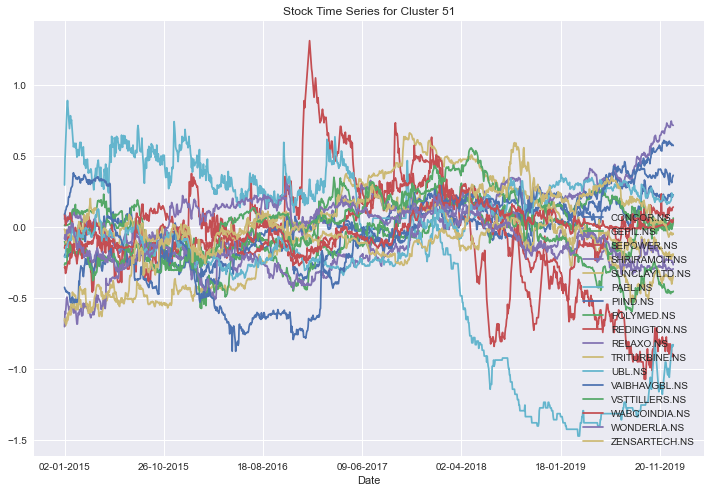

In [77]:
# get the number of stocks in each cluster
counts = clustered_series.value_counts()
plt.figure(figsize=(16,8))

# let's visualize some clusters
cluster_vis_list = list(counts[(counts<=20) & (counts>1)].index)[::-1]
print(len(cluster_vis_list))

# plot a handful of the smallest clusters
for clust in cluster_vis_list:
    tickers = list(clustered_series[clustered_series==clust].index)
    means = np.log(data[tickers].mean())
    dt = np.log(data[tickers]).sub(means)
    dt.plot(title='Stock Time Series for Cluster %d' % clust,figsize=(12,8))
    plt.show()

Now that we have sensible clusters of common stocks, we can validate the cointegration relationships.

In [80]:
def find_cointegrated_pairs(dt, significance=0.05):
    n = dt.shape[1]
    score_matrix = np.zeros((n, n))
    pvalue_matrix = np.ones((n, n))
    keys = dt.keys()
    pairs = []
    for i in range(n):
        for j in range(i+1, n):
            S1 = dt[keys[i]]
            S2 = dt[keys[j]]
            result = coint(S1, S2)
            score = result[0]
            pvalue = result[1]
            score_matrix[i, j] = score
            pvalue_matrix[i, j] = pvalue
            if pvalue < significance:
                pairs.append((keys[i], keys[j]))
    return score_matrix, pvalue_matrix, pairs

In [81]:
import warnings
warnings.filterwarnings('ignore')
cluster_dict = {}
for i, which_clust in enumerate(ticker_count_reduced.index):
    tickers = clustered_series[clustered_series == which_clust].index
    score_matrix, pvalue_matrix, pairs = find_cointegrated_pairs(
        data[tickers]
    )
    cluster_dict[which_clust] = {}
    cluster_dict[which_clust]['score_matrix'] = score_matrix
    cluster_dict[which_clust]['pvalue_matrix'] = pvalue_matrix
    cluster_dict[which_clust]['pairs'] = pairs

### Preview of selected pairs

In [82]:
pairs = []
for clust in cluster_dict.keys():
    pairs.extend(cluster_dict[clust]['pairs'])

print("Total numbers of pairs passed cointegrated test are %d" %len(pairs))
pairs

Total numbers of pairs passed cointegrated test are 181


[('CONCOR.NS', 'PAEL.NS'),
 ('CONCOR.NS', 'VAIBHAVGBL.NS'),
 ('GEPIL.NS', 'UBL.NS'),
 ('SEPOWER.NS', 'SHRIRAMCIT.NS'),
 ('SEPOWER.NS', 'RELAXO.NS'),
 ('SEPOWER.NS', 'TRITURBINE.NS'),
 ('SEPOWER.NS', 'UBL.NS'),
 ('SEPOWER.NS', 'WONDERLA.NS'),
 ('SHRIRAMCIT.NS', 'TRITURBINE.NS'),
 ('SHRIRAMCIT.NS', 'VSTTILLERS.NS'),
 ('FINPIPE.NS', 'KANSAINER.NS'),
 ('FINPIPE.NS', 'LUPIN.NS'),
 ('GSPL.NS', 'KANSAINER.NS'),
 ('GSPL.NS', 'LUPIN.NS'),
 ('GSPL.NS', 'SUNPHARMA.NS'),
 ('GSPL.NS', 'PETRONET.NS'),
 ('HMVL.NS', 'ASTRAZEN.NS'),
 ('IPCALAB.NS', 'ASTRAZEN.NS'),
 ('KANSAINER.NS', 'LUPIN.NS'),
 ('KANSAINER.NS', 'SUNPHARMA.NS'),
 ('KANSAINER.NS', 'PETRONET.NS'),
 ('LUPIN.NS', 'SUNPHARMA.NS'),
 ('LUPIN.NS', 'PETRONET.NS'),
 ('SUNPHARMA.NS', 'PETRONET.NS'),
 ('TORNTPHARM.NS', 'ASTRAZEN.NS'),
 ('BBTC.NS', 'JTEKTINDIA.NS'),
 ('CELEBRITY.NS', 'SICAL.NS'),
 ('CELEBRITY.NS', 'SUMEETINDS.NS'),
 ('CELEBRITY.NS', 'NITINSPIN.NS'),
 ('CELEBRITY.NS', 'PENIND.NS'),
 ('CELEBRITY.NS', 'TTL.NS'),
 ('CELEBRITY.NS', 'ARV

Now we will pass the pairs through another test. This time we will use the hurst exponent to check if a time series is mean-reverting or not. The following function will remove the pairs which fails this test.

In [86]:
def find_hurst(pair , data):
    S1 = pair[0]
    S2 = pair[1]
    ratio = data[S1]/data[S2]
    H, c, data = compute_Hc(ratio)
    
    if H >= 0.5:
        pairs.remove(pair)

In [87]:
for pair in pairs:
    find_hurst(pair , data)

In [88]:
print ("In those pairs, there are %d unique tickers." % len(np.unique(pairs)))

In those pairs, there are 168 unique tickers.


# Pairs Visualization
Lastly, for the pairs we found and validated, let's visualize them in 2d space with T-SNE again.

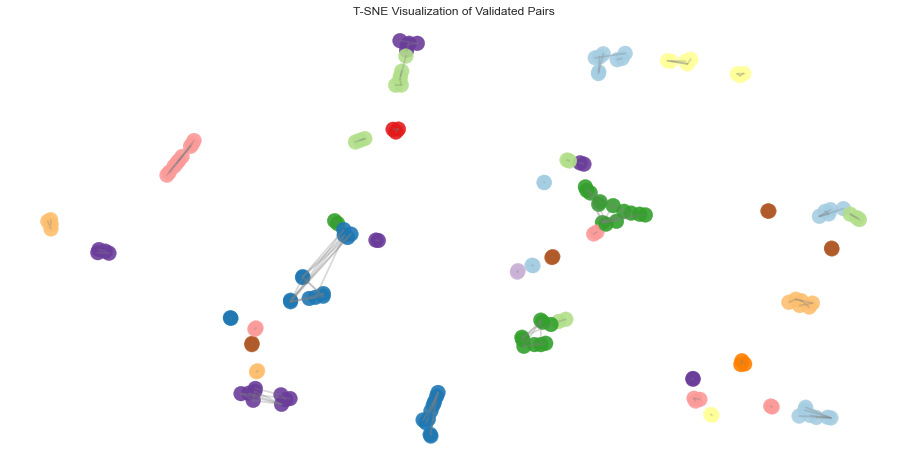

In [89]:
stocks = np.unique(pairs)
X_df = pd.DataFrame(index=returns.T.index, data=X)
in_pairs_series = clustered_series.loc[stocks]
stocks = list(np.unique(pairs))
X_pairs = X_df.loc[stocks]

X_tsne = TSNE(learning_rate=50, perplexity=3, random_state=1337).fit_transform(X_pairs)

plt.figure(1, facecolor='white',figsize=(16,8))
plt.clf()
plt.axis('off')
for pair in pairs:
    ticker1 = pair[0]
    loc1 = X_pairs.index.get_loc(pair[0])
    x1, y1 = X_tsne[loc1, :]

    ticker2 = pair[0]
    loc2 = X_pairs.index.get_loc(pair[1])
    x2, y2 = X_tsne[loc2, :]
      
    plt.plot([x1, x2], [y1, y2], 'k-', alpha=0.3, c='gray');
        
plt.scatter(X_tsne[:, 0], X_tsne[:, 1], s=220, alpha=0.9, c=[in_pairs_series.values], cmap=cm.Paired)
plt.title('T-SNE Visualization of Validated Pairs');

#### Visualising Random pairs behaviour

In [98]:
import random
t_pair = random.choice(pairs)
t_pair

('REPCOHOME.NS', 'ORIENTCEM.NS')

Pvalue for this pair is 0


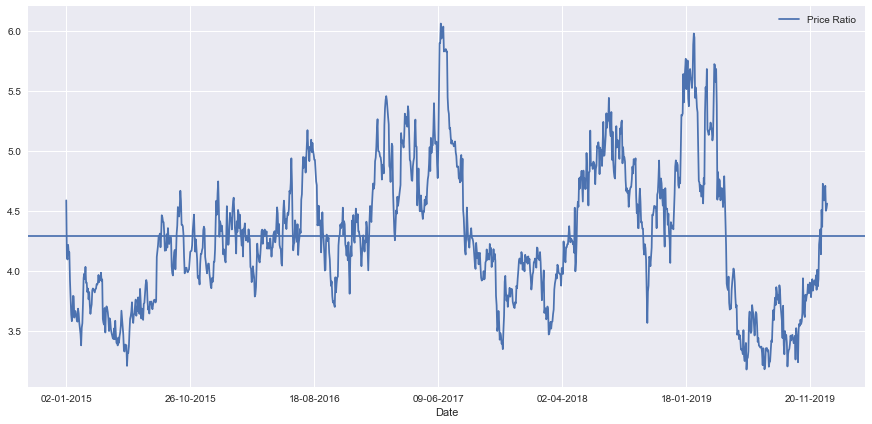

In [99]:
S1 = data[t_pair[0]]
S2 = data[t_pair[1]]
score, pvalue, _ = coint(S1, S2)
print("Pvalue for this pair is %d" %pvalue)
ratios = S1 / S2
ratios.plot(figsize=(15,7))
plt.axhline(ratios.mean())
plt.legend(['Price Ratio'])
plt.show()

The ratio does look like it moved around a stable mean.The absolute ratio isn’t very useful in statistical terms. It is more helpful to normalize our signal by treating it as a z-score. Z score is defined as:

Z Score (Value) = (Value — Mean) / Standard Deviation

WARNING In practice this is usually done to try to give some scale to the data, but this assumes an underlying distribution. Usually normal. However, much financial data is not normally distributed, and we must be very careful not to simply assume normality, or any specific distribution when generating statistics. The true distribution of ratios could be very fat-tailed and prone to extreme values messing up our model and resulting in large losses.

In [100]:
def zscore(series):
    return (series - series.mean()) / np.std(series)

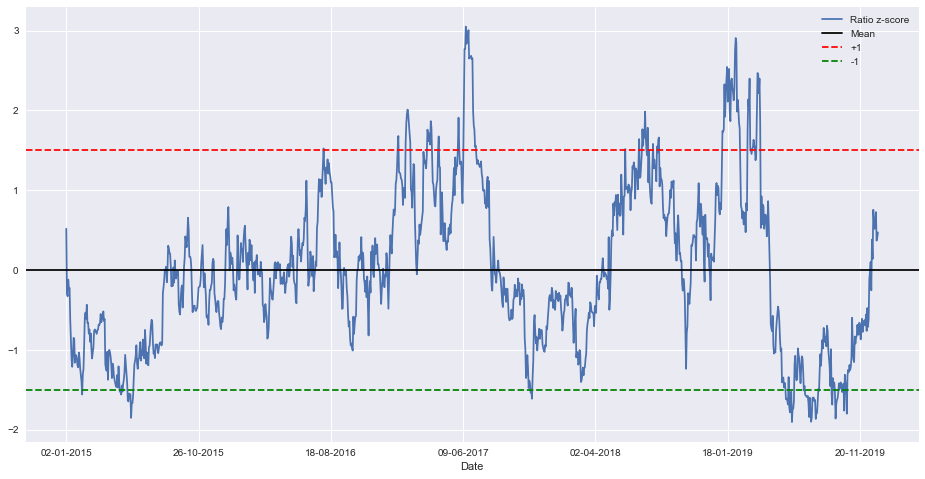

In [101]:
zscore(ratios).plot(figsize=(16,8))
plt.axhline(zscore(ratios).mean(), color='black')
plt.axhline(1.5, color='red', linestyle='--')
plt.axhline(-1.5, color='green', linestyle='--')
plt.legend(['Ratio z-score', 'Mean', '+1', '-1'])
plt.show()

Simple Strategy:
Go "Long" the ratio whenever the z-score is below -1.5
Go "Short" the ratio when the z-score is above 1.5
Exit positions when the z-score approaches zero
This is just the tip of the iceberg, and only a very simplistic example to illustrate the concepts.

In practice you would want to compute a more optimal weighting for how many shares to hold for S1 and S2
You would also want to trade using constantly updating statistics.
In general taking a statistic over your whole sample size can be bad. For example, if the market is moving up, and both securities with it, then your average price over the last 3 years may not be representative of today. For this reason traders often use statistics that rely on rolling windows of the most recent data.

Instead of using ratio values, let's use 1d Moving Average to compute to z score, and the 30d Moving Average and 30d Standard Deviation as the mean and standard deviation.


In [102]:
ratios = S1/S2
print(len(ratios))
train = ratios

1228


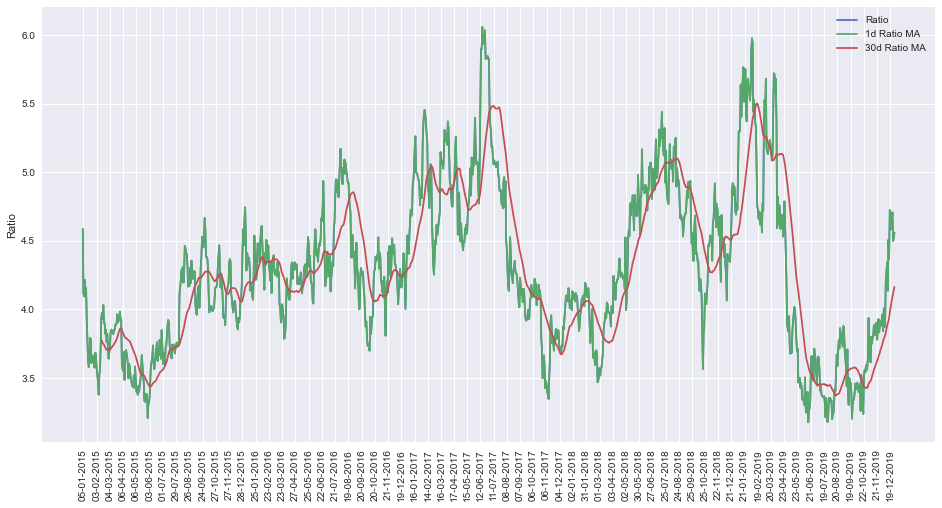

In [103]:
ratios_mavg1 = train.rolling(window=1,center=False).mean()

ratios_mavg30 = train.rolling(window=30,center=False).mean()

std_30 = train.rolling(window=30,center=False).std()

zscore_30_1 = (ratios_mavg1 - ratios_mavg30)/std_30
plt.figure(figsize=(16,8))
plt.plot(train.index, train.values)
plt.plot(ratios_mavg1.index, ratios_mavg1.values)
plt.plot(ratios_mavg30.index, ratios_mavg30.values)

plt.legend(['Ratio','1d Ratio MA', '30d Ratio MA'])
plt.xticks(returns.index[::20],rotation=90)
plt.ylabel('Ratio')
plt.show()

We can use the moving averages to compute the z-score of the ratio at each given time. This will tell us how extreme the ratio is and whether it's a good idea to enter a position at this time. Let's take a look at the z-score now.

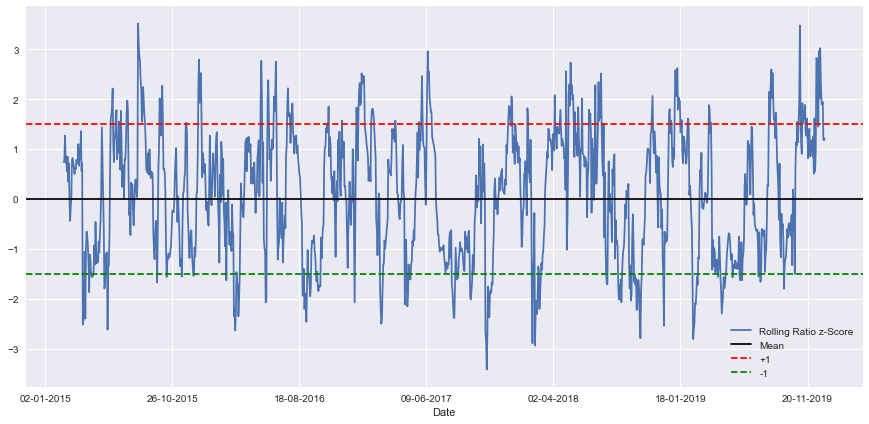

In [104]:
# Take a rolling 60 day standard deviation
std_30 = train.rolling(window=30,center=False).std()
std_30.name = 'std 30d'

# Compute the z score for each day
zscore_30_1 = (ratios_mavg1 - ratios_mavg30)/std_30
zscore_30_1.name = 'z-score'

plt.figure(figsize=(15,7))
zscore_30_1.plot()
plt.axhline(0, color='black')
plt.axhline(1.5, color='red', linestyle='--')
plt.axhline(-1.5, color='green', linestyle='--')
plt.legend(['Rolling Ratio z-Score', 'Mean', '+1', '-1'])
plt.show()

The z-score doesn't mean much out of context, let's plot it next to the prices to get an idea of what it looks like.

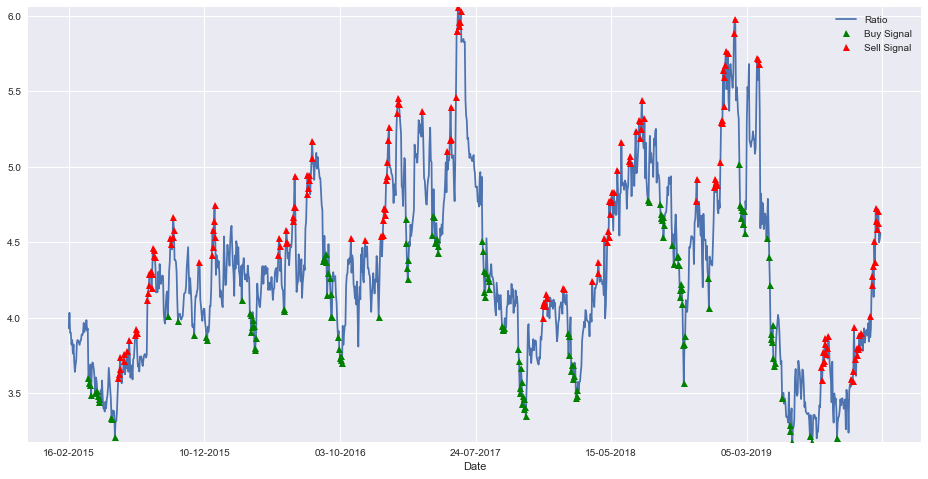

In [105]:
# Plot the ratios and buy and sell signals from z score
plt.figure(figsize=(16,8))

train[30:].plot()
buy = train.copy()
sell = train.copy()
buy[zscore_30_1>-1.5] = 0
sell[zscore_30_1<1.5] = 0
buy[30:].plot(color='g', linestyle='None', marker='^')
sell[30:].plot(color='r', linestyle='None', marker='^')
x1,x2,y1,y2 = plt.axis()
plt.axis((x1,x2,ratios.min(),ratios.max()))
plt.legend(['Ratio', 'Buy Signal', 'Sell Signal'])
plt.show()

What does that mean for actual stocks that we are trading? Let’s take a look

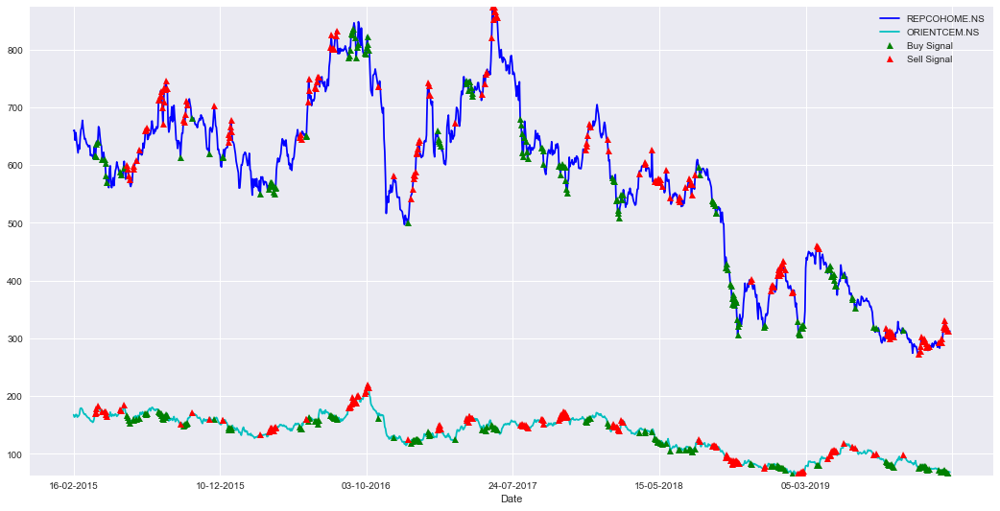

In [106]:
# Plot the prices and buy and sell signals from z score
plt.figure(figsize=(18,9))

S1[30:].plot(color='b')
S2[30:].plot(color='c')
buyR = 0*S1.copy()
sellR = 0*S1.copy()

# When buying the ratio, buy S1 and sell S2
buyR[buy!=0] = S1[buy!=0]
sellR[buy!=0] = S2[buy!=0]
# When selling the ratio, sell S1 and buy S2 
buyR[sell!=0] = S2[sell!=0]
sellR[sell!=0] = S1[sell!=0]

buyR[30:].plot(color='g', linestyle='None', marker='^')
sellR[30:].plot(color='r', linestyle='None', marker='^')
x1,x2,y1,y2 = plt.axis()
plt.axis((x1,x2,min(S1.min(),S2.min()),max(S1.max(),S2.max())))

plt.legend([t_pair[0],t_pair[1], 'Buy Signal', 'Sell Signal'])
plt.show()


# Trading Algorithm

In [107]:
def trade(S1, S2,money, window1=1, window2=30):
    # If window length is 0, algorithm doesn't make sense, so exit
    if (window1 == 0) or (window2 == 0):
        return 0
    # Compute rolling mean and rolling standard deviation
    ratios = S1/S2
    ma1 = ratios.rolling(window=window1,
                               center=False).mean()
    ma2 = ratios.rolling(window=window2,
                               center=False).mean()
    std = ratios.rolling(window=window2,
                        center=False).std()
    zscore = (ma1 - ma2)/std
    # Simulate trading
    # Start with no money and no positions
    countS1 = 0
    countS2 = 0
    first_time = [0,0]
    profit=0
    c1=0
    c2=0
    mon_list = pd.Series(index=returns.index)
    mon_list[mon_list.index==returns.index[0]] = money
    for i in range(len(ratios)):       
        
        # Sell short if the z-score is > 1,5
        if zscore[i] > 1.5 and money>max(S1[i],S2[i]) and c1==0:
            countS1 -= int((money/2)/S1[i])
            countS2 += int((money/2)/S2[i])
            first_time = [S1[i],S2[i]]
            money -= -countS1*S1[i] +  countS2*S2[i]
            c1=1
        # Buy long if the z-score is < -1.5
        elif zscore[i] < -1.5 and money>max(S1[i],S2[i]) and c2==0:
            countS1 += int((money/2)/S1[i])
            countS2 -= int((money/2)/S2[i])
            first_time =  [S1[i],S2[i]]
            money -= countS1*S1[i] - countS2*S2[i]
            c2=1

        # Clear positions if the z-score between -.1and .1
        elif abs(zscore[i]) < 0.1:
            profit= countS1*(S1[i]-first_time[0]) + countS2*(S2[i]-first_time[1])
            if(c1==1):
                money += -countS1*first_time[0] + countS2*first_time[1] + profit
                c1=0
            if(c2==1):    
                money += countS1*first_time[0] - countS2*first_time[1] + profit
                c2=0
            countS1 = 0
            countS2 = 0  
            mon_list[mon_list.index==data.index[i]] = money
            
        
        #if(i == len(ratios)-1):
         
            #money += abs(countS1)*first_time[0] + abs(countS2)*first_time[1]
            #mon_list[mon_list.index==data.index[i]] = money
            
            
            #mon_list.append((data.index[i],money))
    return mon_list

## Reading Nifty data for Benchmarks

In [108]:
nifty_50 = pd.read_csv('^NSEI.csv',index_col='Date')['Adj Close']

cum_returns_nifty = (nifty_50 - nifty_50[0])*100/nifty_50
cum_returns_nifty.tail()
cum_returns_nifty.name = 'NIFTY-50'

In [109]:
benchmark = cum_returns_nifty[-1]
print("Benchmark is %d%%" %benchmark)

Benchmark is 31%


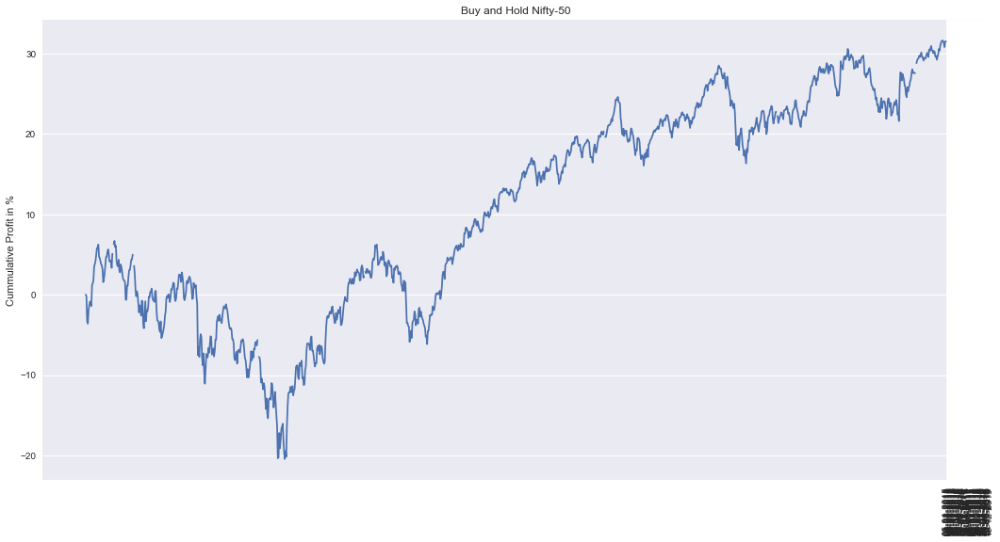

In [110]:
plt.figure(figsize=(18,9))
plt.plot(cum_returns_nifty)
plt.xticks(returns.index[::20],rotation=90)
plt.ylabel("Cummulative Profit in %")
plt.title("Buy and Hold Nifty-50")
plt.show()

## Trade all pairs listed by DBSCAN algorithm

In [171]:
f_output = pd.DataFrame(index=returns.index)
final_pairs=[]
for pr in pairs:
    S1 = data[pr[0]]
    S2 = data[pr[1]]
    initial_money = 100000
    amt_list = trade(S1,S2,initial_money)
    amt_list.fillna(method='ffill',inplace=True)
    amt_list.name = pr[0]+"-"+pr[1]
    increment = (amt_list-initial_money)*100/initial_money
    #amt_list = pd.DataFrame(amt_list)
    if(increment[-1]>benchmark): 
        f_output =  pd.concat([f_output,increment],axis=1)
        final_pairs.append(((increment[-1]),str(pr)))
        
         
final_pairs.sort(reverse=True)  

In [172]:
f_output

,SEPOWER.NS-UBL.NS,SHRIRAMCIT.NS-TRITURBINE.NS,GSPL.NS-KANSAINER.NS,GSPL.NS-SUNPHARMA.NS,GSPL.NS-PETRONET.NS,KANSAINER.NS-PETRONET.NS,CELEBRITY.NS-PENIND.NS,CELEBRITY.NS-TTL.NS,CELEBRITY.NS-ARVIND.NS,INDORAMA.NS-ARVIND.NS,...,CORDSCABLE.NS-ELECTCAST.NS,REPCOHOME.NS-ORIENTCEM.NS,SMARTLINK.NS-ZEELEARN.NS,MANGTIMBER.NS-RPPINFRA.NS,CUB.NS-HDFCBANK.NS,SARDAEN.NS-SUNFLAG.NS,TI.NS-APOLLOTYRE.NS,GSCLCEMENT.NS-KCP.NS,KOTHARIPET.NS-WEIZMANIND.NS,BEPL.NS-GOACARBON.NS
Date,,,,,,,,,,,,,,,,,,,,,
05-01-2015,0.000000,0.00000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.0000,0.000000,0.000000,0.000000,0.000000
06-01-2015,0.000000,0.00000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.0000,0.000000,0.000000,0.000000,0.000000
07-01-2015,0.000000,0.00000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.0000,0.000000,0.000000,0.000000,0.000000
08-01-2015,0.000000,0.00000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.0000,0.000000,0.000000,0.000000,0.000000
09-01-2015,0.000000,0.00000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.0000,0.000000,0.000000,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
23-12-2019,162.559183,44.32425,49.09225,39.389215,59.911418,37.925276,229.668308,134.492768,90.315091,230.458825,...,148.675557,45.910179,37.432551,82.995599,56.148316,48.0814,63.555769,81.007236,61.502163,64.923926
24-12-2019,162.559183,44.32425,49.09225,39.389215,59.911418,37.925276,229.668308,134.492768,90.315091,230.458825,...,148.675557,45.910179,37.432551,82.995599,56.148316,48.0814,63.555769,81.007236,61.502163,64.923926
26-12-2019,162.559183,44.32425,49.09225,39.389215,59.911418,37.925276,229.668308,134.492768,90.315091,230.458825,...,148.675557,45.910179,37.432551,82.995599,56.148316,48.0814,63.555769,81.007236,61.502163,64.923926


In [177]:
new_columns = f_output.columns[f_output.loc[f_output.last_valid_index()].argsort()]
f_output=f_output[new_columns]
f_output = f_output[~f_output.index.duplicated(keep='first')]
f_output.index = pd.to_datetime(f_output.index , format = "%d-%m-%Y")
cum_returns_nifty.index = pd.to_datetime(cum_returns_nifty.index)
f_output = pd.concat([f_output,cum_returns_nifty],axis=1,join='inner')
f_output

,FOSECOIND.NS-AMBUJACEM.NS,FOSECOIND.NS-ACC.NS,SMARTLINK.NS-ZEELEARN.NS,KANSAINER.NS-PETRONET.NS,GSPL.NS-SUNPHARMA.NS,JAYSREETEA.NS-KCPSUGIND.NS,20MICRONS.NS-AROGRANITE.NS,SETUINFRA.NS-VSSL.NS,CERA.NS-ACC.NS,SKIL.NS-SUPERHOUSE.NS,...,CORDSCABLE.NS-ELECTCAST.NS,SEPOWER.NS-UBL.NS,TNPL.NS-AROGRANITE.NS,INDORAMA.NS-ARVIND.NS,CELEBRITY.NS-PENIND.NS,SUTLEJTEX.NS-TATACOFFEE.NS,UNIONBANK.NS-AUTOLITIND.NS,SHIRPUR-G.NS-MCDHOLDING.NS,SETUINFRA.NS-SNOWMAN.NS,NIFTY-50
Date,,,,,,,,,,,,,,,,,,,,,
2015-01-05,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000,0.000000,0.0000,-0.203497
2015-01-06,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000,0.000000,0.0000,-3.298739
2015-01-07,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000,0.000000,0.0000,-3.620667
2015-01-08,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000,0.000000,0.0000,-1.953350
2015-01-09,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000,0.000000,0.0000,-1.339250
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2019-12-23,32.449464,35.851021,37.432551,37.925276,39.389215,40.821913,41.800809,42.617955,42.642978,44.217062,...,148.675557,162.559183,177.211597,230.458825,229.668308,251.711988,346.256,365.599711,467.4369,31.536970
2019-12-24,32.449464,35.851021,37.432551,37.925276,39.389215,40.821913,41.800809,42.617955,42.642978,44.217062,...,148.675557,162.559183,177.211597,230.458825,229.668308,251.711988,346.256,365.599711,467.4369,31.266806
2019-12-26,32.449464,35.851021,37.432551,37.925276,39.389215,40.821913,41.800809,42.617955,42.642978,44.217062,...,148.675557,162.559183,177.211597,230.458825,229.668308,251.711988,346.256,365.599711,467.4369,30.768023


In [181]:
returns.index = pd.to_datetime(returns.index , format = "%d-%m-%Y")

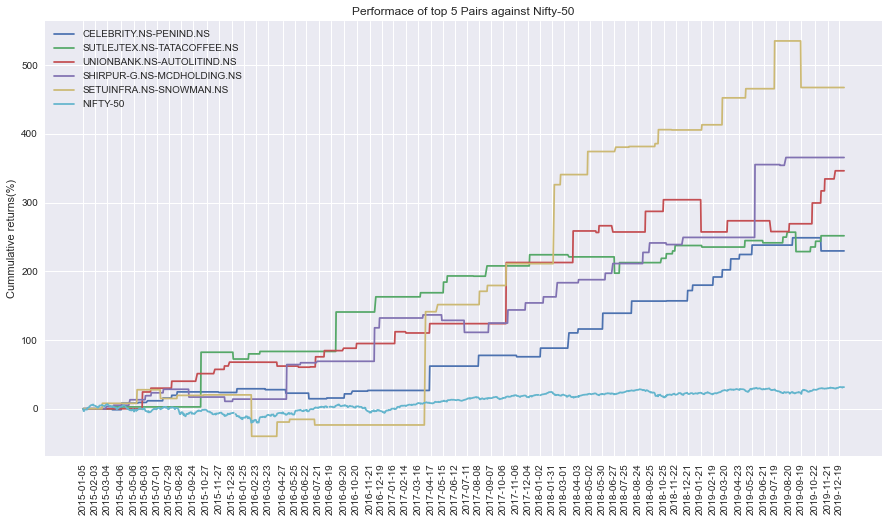

In [182]:
plt.figure(figsize=(15,8))
plt.plot(f_output.iloc[:,-6:],)
plt.xticks(returns.index[::20],rotation=90)
plt.ylabel("Cummulative returns(%)")
plt.title("Performace of top 5 Pairs against Nifty-50")
plt.legend(f_output.columns[-6:])
plt.show()

#### Pairs out-performs the benchmark

In [183]:
print("Total pairs outperforms the benchmark are %d" %len(final_pairs))
f_output.iloc[-1,:]

Total pairs outperforms the benchmark are 39


FOSECOIND.NS-AMBUJACEM.NS       32.449464
FOSECOIND.NS-ACC.NS             35.851021
SMARTLINK.NS-ZEELEARN.NS        37.432551
KANSAINER.NS-PETRONET.NS        37.925276
GSPL.NS-SUNPHARMA.NS            39.389215
JAYSREETEA.NS-KCPSUGIND.NS      40.821913
20MICRONS.NS-AROGRANITE.NS      41.800809
SETUINFRA.NS-VSSL.NS            42.617955
CERA.NS-ACC.NS                  42.642978
SKIL.NS-SUPERHOUSE.NS           44.217062
SHRIRAMCIT.NS-TRITURBINE.NS     44.324250
REPCOHOME.NS-ORIENTCEM.NS       45.910179
SARDAEN.NS-SUNFLAG.NS           48.081400
SUPERHOUSE.NS-TBZ.NS            48.083133
GSPL.NS-KANSAINER.NS            49.092250
HINDMOTORS.NS-LUMAXTECH.NS      53.800635
CUB.NS-HDFCBANK.NS              56.148316
KAMDHENU.NS-WELENT.NS           58.066512
GSPL.NS-PETRONET.NS             59.911418
KOTHARIPET.NS-WEIZMANIND.NS     61.502163
TI.NS-APOLLOTYRE.NS             63.555769
JKTYRE.NS-ASAL.NS               63.608467
BEPL.NS-GOACARBON.NS            64.923926
HINDMOTORS.NS-ASAL.NS           70

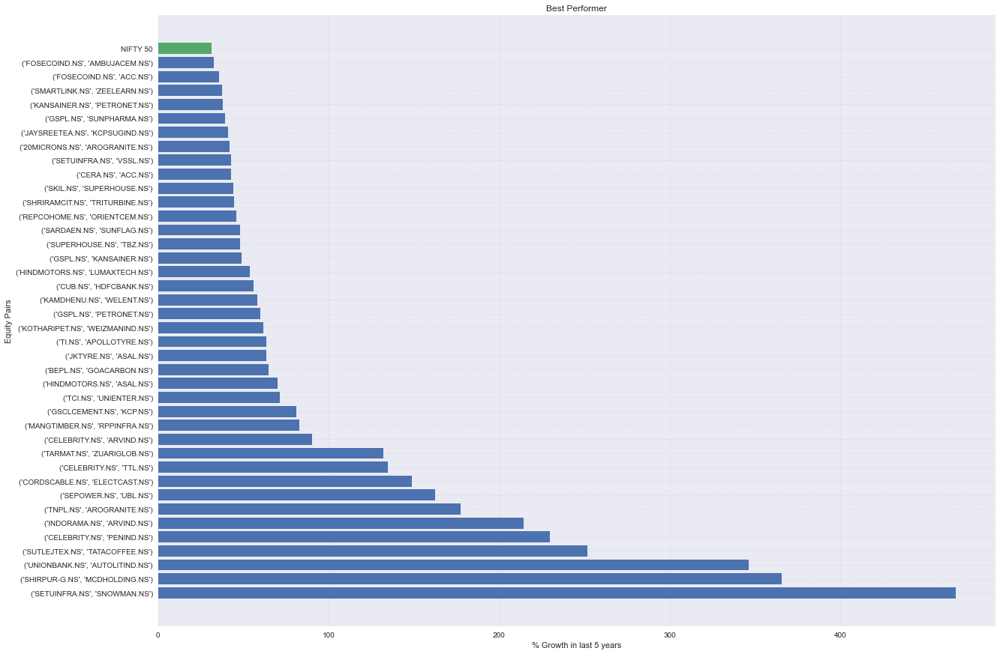

In [184]:
Cumm_Profit = []
Valuable_pairs =[]
for l in final_pairs:
    Cumm_Profit.append(l[0])
    Valuable_pairs.append(l[1])
d_plot = pd.DataFrame(Cumm_Profit,index= Valuable_pairs)    
fig, ax = plt.subplots(figsize =(20, 15))
ax.grid(b = True, color ='grey', 
        linestyle ='-.', linewidth = 0.5, 
        alpha = 0.2) 
ax.barh(d_plot.index,d_plot[0]) 
ax.barh("NIFTY 50",benchmark)
ax.set_title('Best Performer' )
plt.xlabel("% Growth in last 5 years")
plt.ylabel("Equity Pairs")
plt.show() 

39 PAIRS OUTPERFORMS NIFTY-50 WITH MAXIMUM PROFIT OF 467% ON SINGLE PAIR OVER SPAN OF 5 YEARS


## Conclusion and Next Steps



We have found a nice number of pairs to use in a pairs trading strategy.We will need to take some special precautions in the Portfolio Construction stage to avoid excessive concentration of any one stock.Although all pairs does not perform as expected and showed errosive nature to our capital.There is need to optimised the algorithm with additional information on financial health or future expansion or quaterly results to cluster down the stocks more accurately.




Happy hunting for pairs!